In [1]:
from IPython.display import Image
from IPython.core.display import HTML 

import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv


def generateMosaic(img):
    h, w = img.shape[:2]
    mosaic = np.zeros((h,w))
    mask = np.zeros((h, w)).astype("uint8")
    
    for i in range(0, h, 2):
        for j in range(0, w, 2):
            mosaic[i, j] = img[i, j, 2]
            mask[i, j] = 2
            
    for i in range(1, h, 2):
        for j in range(1, w, 2):
            mosaic[i, j] = img[i, j, 0]
            mask[i, j] = 0
            
    for i in range(0, h, 2):
        for j in range(1, w, 2):
            mosaic[i, j] = img[i, j, 1]
            mask[i, j] = 1
            
    for i in range(1, h, 2):
        for j in range(0, w, 2):
            mosaic[i, j] = img[i, j, 1]
            mask[i, j] = 1
            
    return mosaic, mask

def calculateValueInterpolation(i, j, mosaic, mask, layer):
    
    output = 0
    counter = 0
    
    if mask[i, j] == layer:
        return mosaic[i, j]
    
    if mask[i-1, j-1] == layer:
        output += mosaic[i-1, j-1]
        counter += 1
        
    if mask[i-1, j] == layer:
        output += mosaic[i-1, j]
        counter += 1
        
    if mask[i-1, j+1] == layer:
        output += mosaic[i-1, j+1]
        counter += 1
        
    if mask[i, j-1] == layer:
        output += mosaic[i, j-1]
        counter += 1
        
    if mask[i, j+1] == layer:
        output += mosaic[i, j+1]
        counter += 1
        
    if mask[i+1, j-1] == layer:
        output += mosaic[i+1, j-1]
        counter += 1
        
    if mask[i+1, j] == layer:
        output += mosaic[i+1, j]
        counter += 1
        
    if mask[i+1, j+1] == layer:
        output += mosaic[i+1, j+1]
        counter += 1
        
    return output / counter
        
        
def toDemosaicInterpolation(mosaic, mask):
    h, w = mosaic.shape[:2]
    
    output = np.zeros((h, w, 3)).astype("uint8")
    
    for layer in range(3):
        for i in range(1, h-1):
            for j in range(1, w-1):
                
                output[i, j, layer] = calculateValueInterpolation(i, j, mosaic, mask, layer)
                
    return output


def calculateValueMalvar(i, j, mosaic, mask):
    
    mask1 = np.array([[0, 0, -1, 0, 0],
                      [0, 0, 2, 0, 0],
                      [-1, 2, 4, 2, -1],
                      [0, 0, 2, 0, 0],
                      [0, 0, -1, 0, 0]]) / 8
    
    mask2 = np.array([[0, 0, 0.5, 0, 0],
                      [0, -1, 0, -1, 0],
                      [-1, 4, 5, 4, -1],
                      [0, -1, 0, -1, 0],
                      [0, 0, 0.5, 0, 0]]) / 8
    
    mask3 = np.array([[0, 0, -1, 0, 0],
                      [0, -1, 4, -1, 0],
                      [0.5, 0, 5, 0, 0.5],
                      [0, -1, 4, -1, 0],
                      [0, 0, -1, 0, 0]]) / 8
    
    mask4 = np.array([[0, 0, -1.5, 0, 0],
                      [0, 2, 0, 2, 0],
                      [-1.5, 0, 6, 0, -1.5],
                      [0, 2, 0, 2, 0],
                      [0, 0, -1.5, 0, 0]]) / 8
    
    output = np.zeros(3)
    
    if mask[i, j] == 0:
        output[0] = mosaic[i, j]
        
        output[1] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask1)
        
        output[2] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask4)
        
        output[output > 255] = 255
        output[output < 0] = 0
        
        return output
    
    
    if mask[i, j] == 1:
        if mask[i, j+1] == 0:
            output[0] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask2)
        else:
            output[0] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask3)
        
        output[1] = mosaic[i, j]
        
        if mask[i, j+1] == 2:
            output[2] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask2)
        else:
            output[2] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask3)
            
        output[output > 255] = 255
        output[output < 0] = 0
        
        return output
        
        
    if mask[i, j] == 2:
        
        output[0] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask4)
        
        output[1] = np.sum(mosaic[i-2:i+3, j-2:j+3] * mask1)

        output[2] = mosaic[i, j]
        
        output[output > 255] = 255
        output[output < 0] = 0
        
        return output
        


def toDemosaicMalvar(mosaic, mask):
    h, w = mosaic.shape[:2]
    
    output = np.zeros((h, w, 3)).astype("uint8")
    
    for i in range(2, h-2):
        for j in range(2, w-2):

            output[i, j] = calculateValueMalvar(i, j, mosaic, mask)
            
                
    return output

---
# Original image

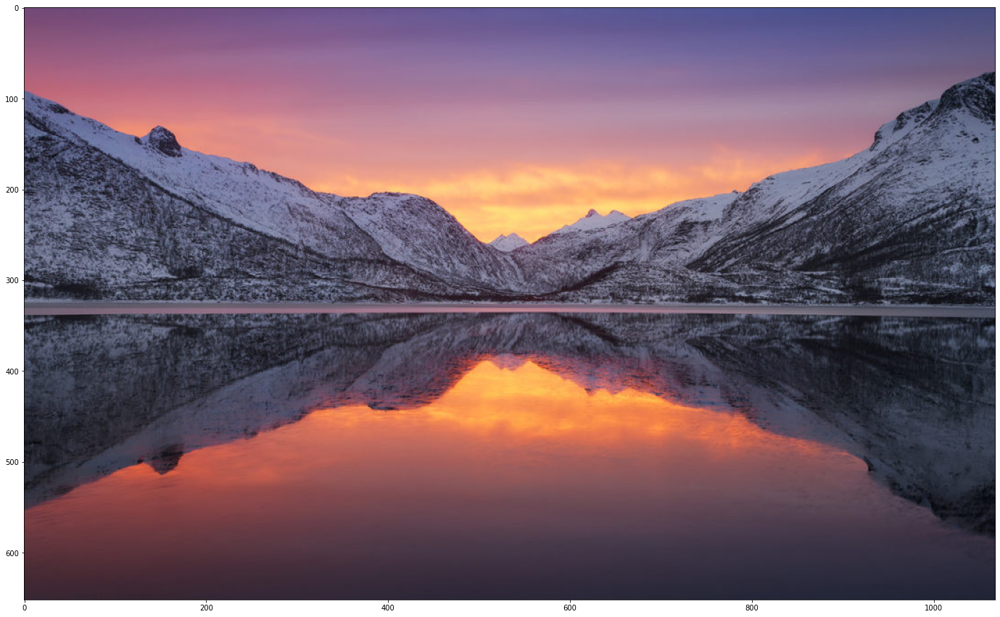

In [2]:
img1 = plt.imread("arctic-fire-1068x652.jpg")

fig = plt.figure(figsize=(24,18))
plt.imshow(img1)
plt.show()

# Mosaic Process

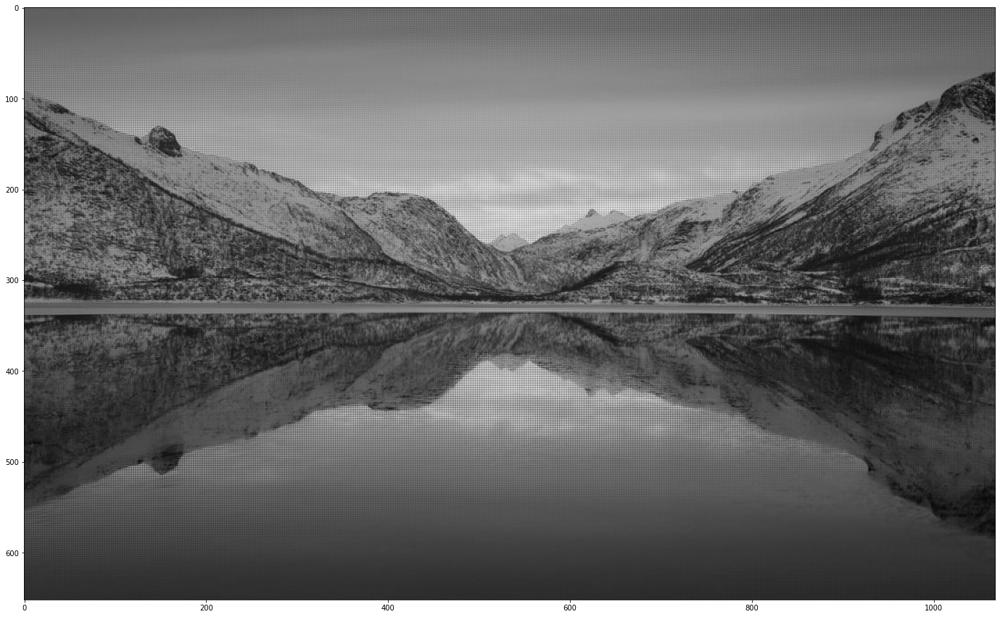

In [3]:
mosaic1, mask1 = generateMosaic(img1)

fig = plt.figure(figsize=(24,18))
plt.imshow(mosaic1, cmap="gray")
plt.show()

# Demosaic Process - interpolation algorithm

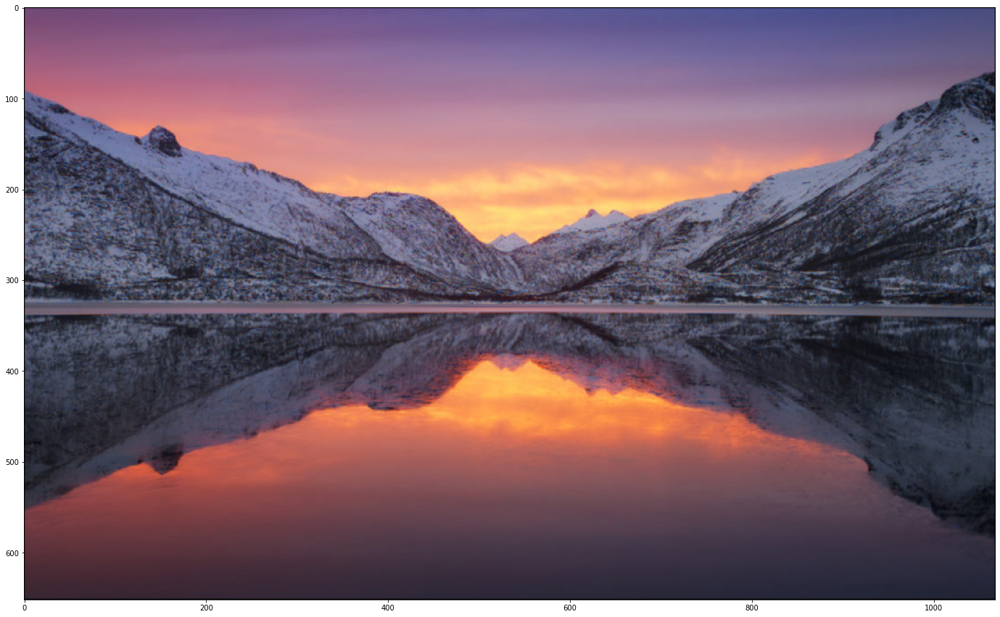

In [4]:
demosaic11 = toDemosaicInterpolation(mosaic1, mask1)

fig = plt.figure(figsize=(24,18))
plt.imshow(demosaic11)
plt.show()

# Demosaic Process - Malvar algorithm

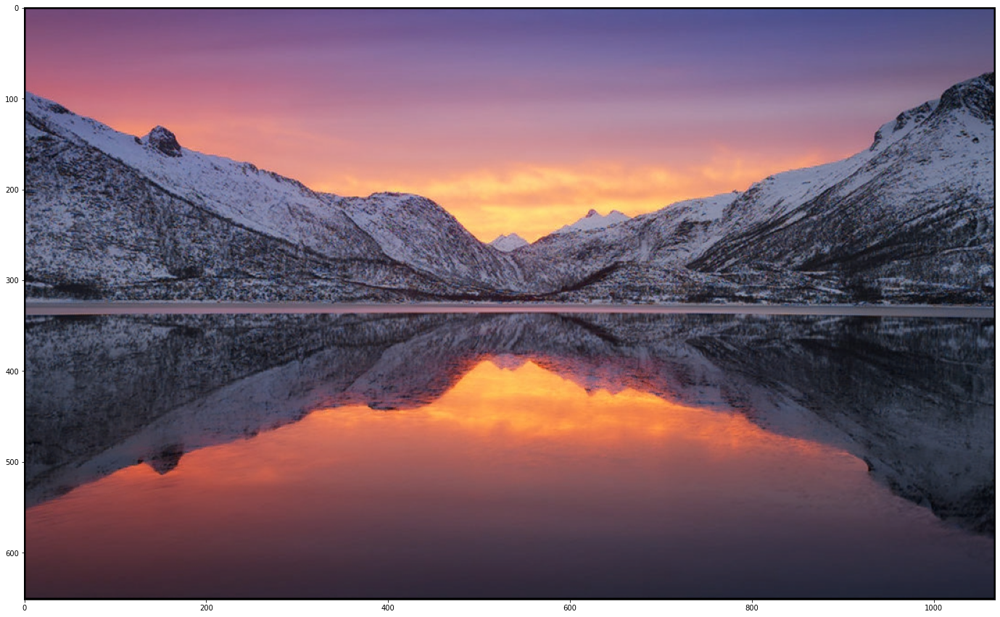

In [5]:
demosaic12 = toDemosaicMalvar(mosaic1, mask1)

fig = plt.figure(figsize=(24,18))
plt.imshow(demosaic12)
plt.show()

---
# Original Image

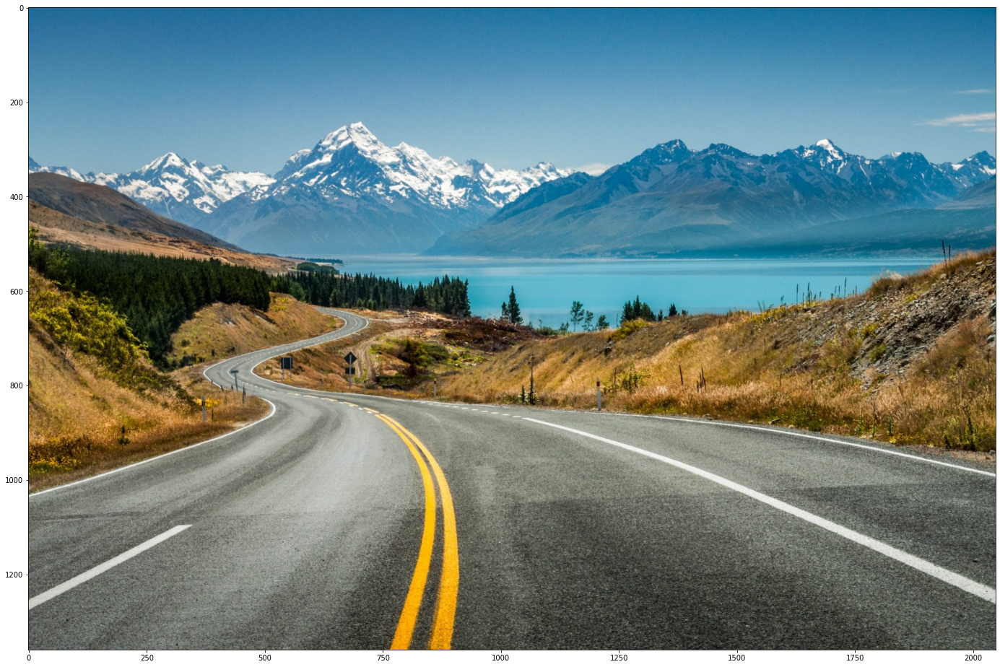

In [6]:
img2 = plt.imread("landscape new zealand S-shape.jpg")

fig = plt.figure(figsize=(24,18))
plt.imshow(img2)
plt.show()

# Mosaic Process

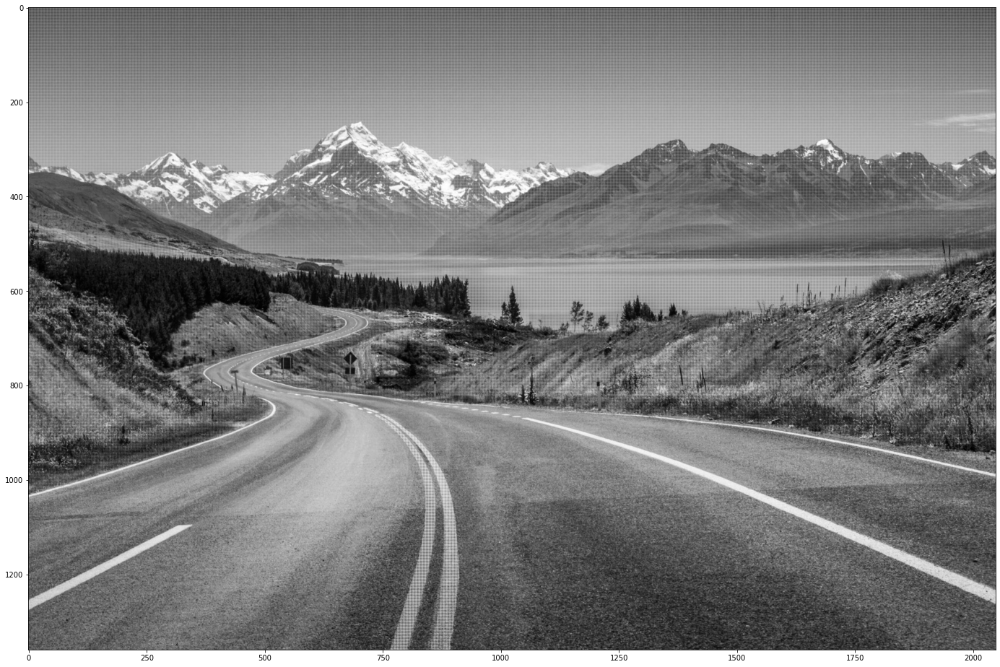

In [7]:
mosaic2, mask2 = generateMosaic(img2)

fig = plt.figure(figsize=(24,18))
plt.imshow(mosaic2, cmap="gray")
plt.show()

# Demosaic Process - interpolation algorithm

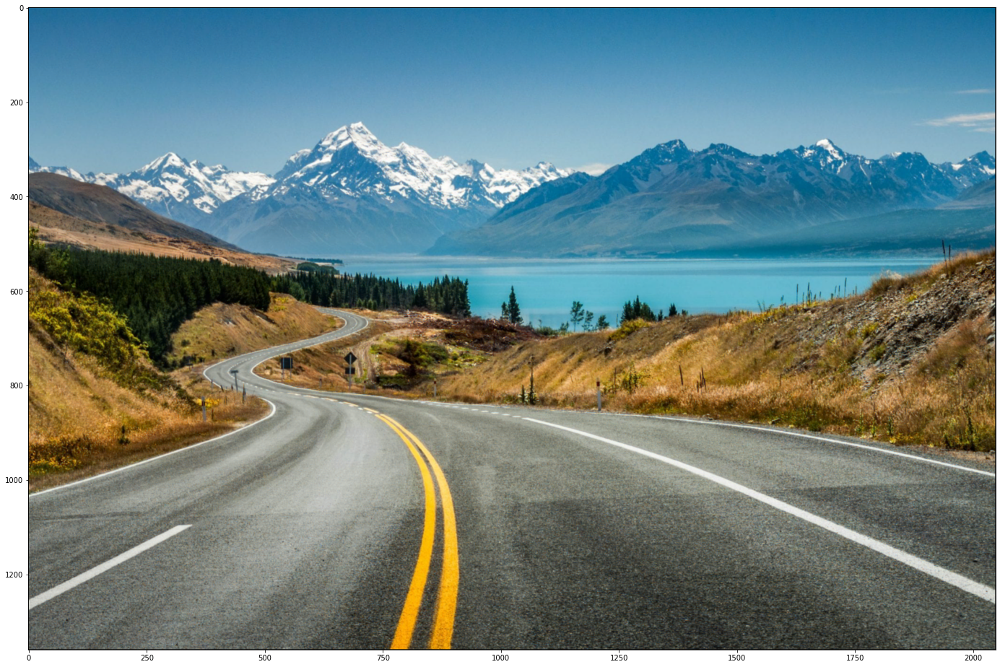

In [8]:
demosaic21 = toDemosaicInterpolation(mosaic2, mask2)

fig = plt.figure(figsize=(24,18))
plt.imshow(demosaic21)
plt.show()

# Demosaic Process - Malvar algorithm

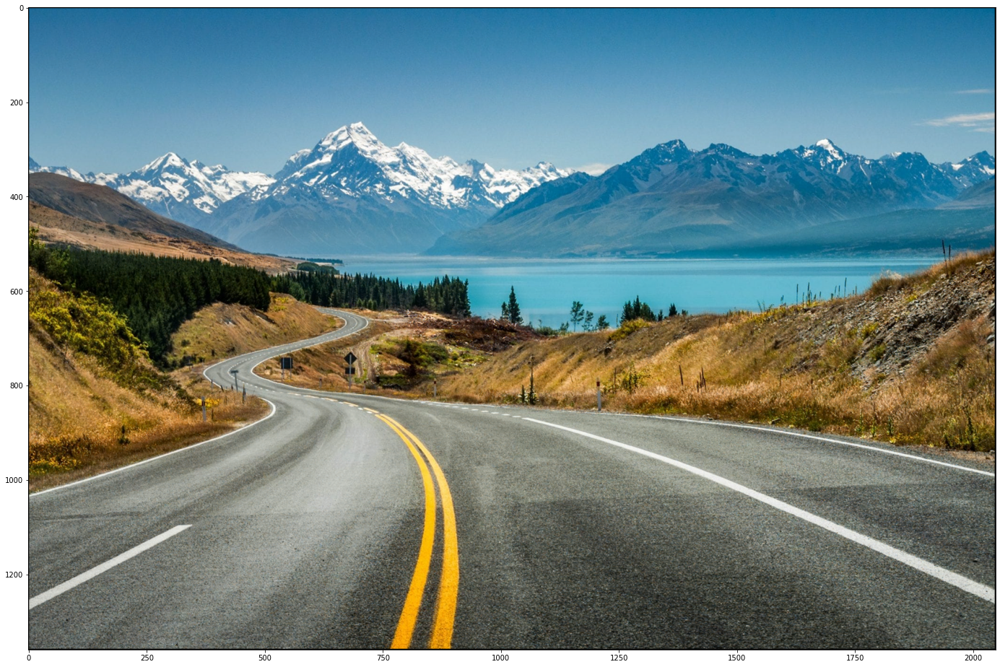

In [9]:
demosaic22 = toDemosaicMalvar(mosaic2, mask2)

fig = plt.figure(figsize=(24,18))
plt.imshow(demosaic22)
plt.show()

---
# Original Image

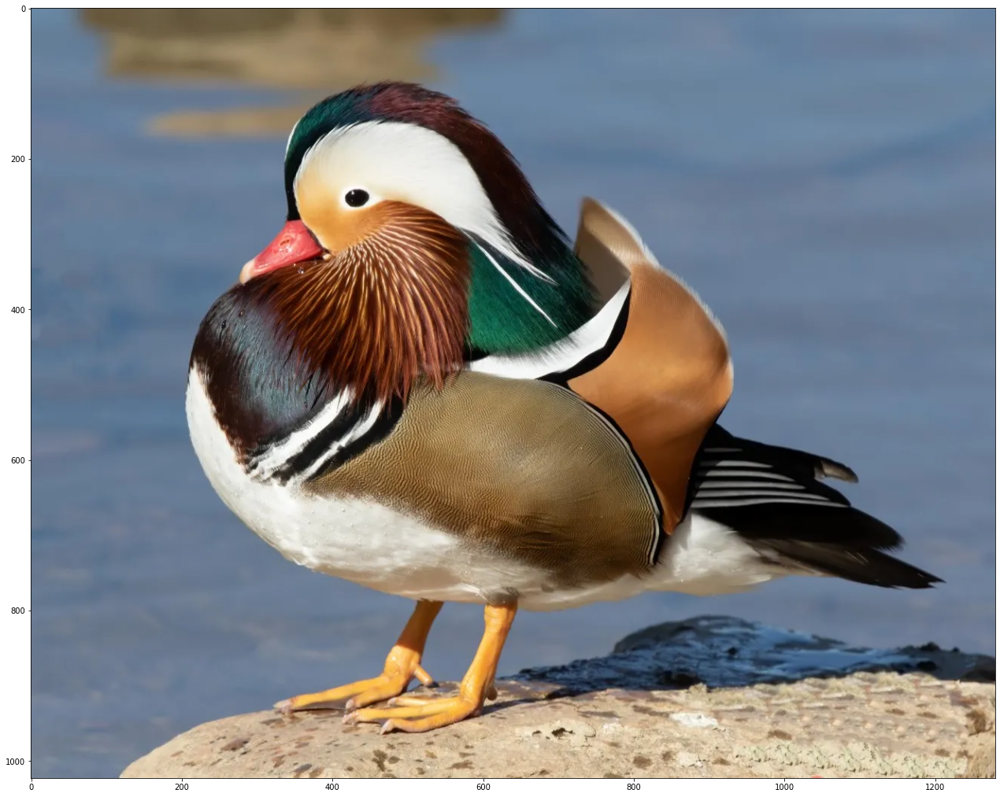

In [10]:
img3 = plt.imread("5323fae3-b3ee-43f6-a25a-2023d3842e21-hot_duck.webp")

fig = plt.figure(figsize=(24,18))
plt.imshow(img3)
plt.show()

# Mosaic Process

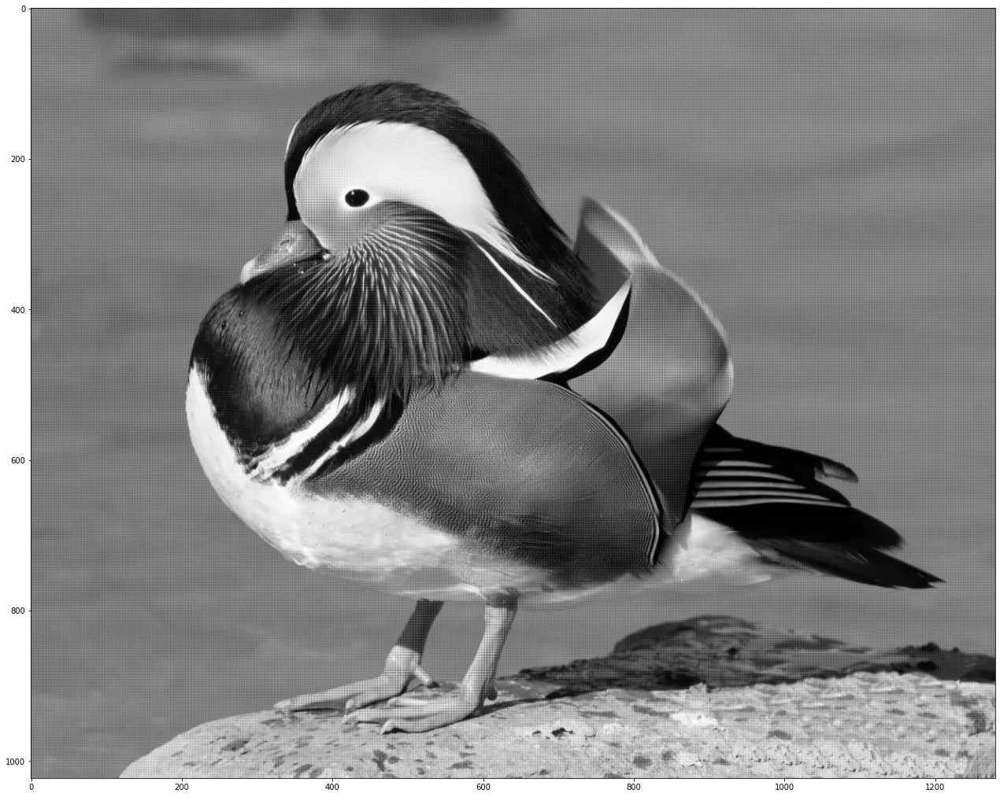

In [11]:
mosaic3, mask3 = generateMosaic(img3)

fig = plt.figure(figsize=(24,18))
plt.imshow(mosaic3, cmap="gray")
plt.show()

# Demosaic Process - interpolation algorithm

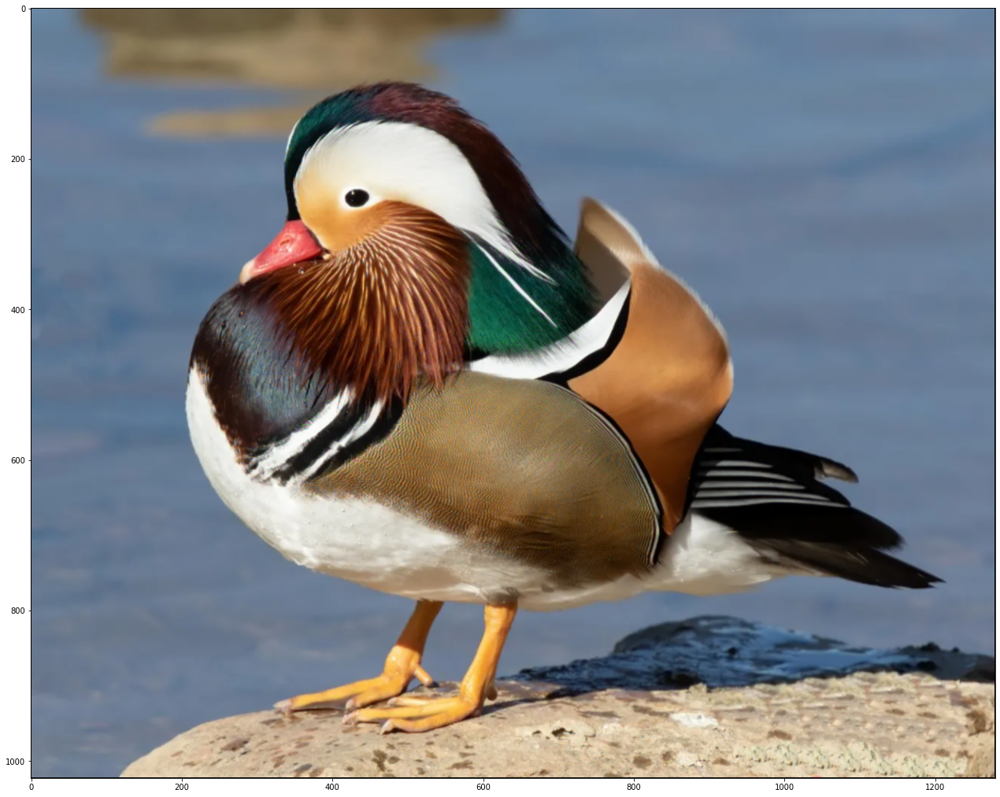

In [12]:
demosaic31 = toDemosaicInterpolation(mosaic3, mask3)

fig = plt.figure(figsize=(24,18))
plt.imshow(demosaic31)
plt.show()

# Demosaic Process - Malvar algorithm

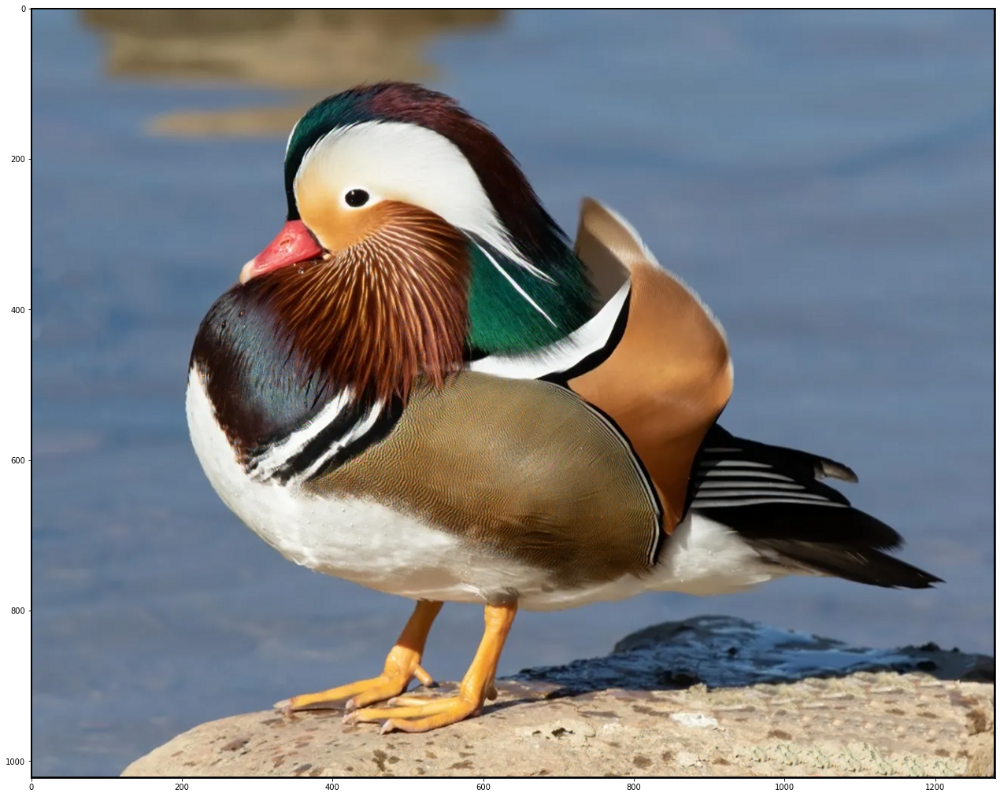

In [13]:
demosaic32 = toDemosaicMalvar(mosaic3, mask3)

fig = plt.figure(figsize=(24,18))
plt.imshow(demosaic32)
plt.show()

---
# Image quality comparison - Peak Signal-to-Noise Ratio

## Interpolation algorithm

In [14]:
print(f"Red:   {cv.PSNR(img1[:, :, 0], demosaic11[:, :, 0])}")
print(f"Green: {cv.PSNR(img1[:, :, 1], demosaic11[:, :, 1])}")
print(f"Blue:  {cv.PSNR(img1[:, :, 2], demosaic11[:, :, 2])}")

Red:   29.5525616784388
Green: 32.071208581162594
Blue:  28.32485824737126


## Malvar algorithm

In [15]:
print(f"Red:   {cv.PSNR(img1[:, :, 0], demosaic12[:, :, 0])}")
print(f"Green: {cv.PSNR(img1[:, :, 1], demosaic12[:, :, 1])}")
print(f"Blue:  {cv.PSNR(img1[:, :, 2], demosaic12[:, :, 2])}")

Red:   29.56213755905054
Green: 31.074288245933058
Blue:  27.492170000170173


## Interpolation algorithm

In [16]:
print(f"Red:   {cv.PSNR(img2[:, :, 0], demosaic21[:, :, 0])}")
print(f"Green: {cv.PSNR(img2[:, :, 1], demosaic21[:, :, 1])}")
print(f"Blue:  {cv.PSNR(img2[:, :, 2], demosaic21[:, :, 2])}")

Red:   30.061264007023148
Green: 31.605186035707735
Blue:  29.096298147409136


## Malvar algorithm

In [17]:
print(f"Red:   {cv.PSNR(img2[:, :, 0], demosaic22[:, :, 0])}")
print(f"Green: {cv.PSNR(img2[:, :, 1], demosaic22[:, :, 1])}")
print(f"Blue:  {cv.PSNR(img2[:, :, 2], demosaic22[:, :, 2])}")

Red:   31.463879642873724
Green: 30.37800429458542
Blue:  29.05357414562163


## Interpolation algorithm

In [18]:
print(f"Red:   {cv.PSNR(img3[:, :, 0], demosaic31[:, :, 0])}")
print(f"Green: {cv.PSNR(img3[:, :, 1], demosaic31[:, :, 1])}")
print(f"Blue:  {cv.PSNR(img3[:, :, 2], demosaic31[:, :, 2])}")

Red:   28.331239318679977
Green: 28.977077487718816
Blue:  28.23898257708118


## Malvar algorithm

In [19]:
print(f"Red:   {cv.PSNR(img3[:, :, 0], demosaic32[:, :, 0])}")
print(f"Green: {cv.PSNR(img3[:, :, 1], demosaic32[:, :, 1])}")
print(f"Blue:  {cv.PSNR(img3[:, :, 2], demosaic32[:, :, 2])}")

Red:   26.356553100293176
Green: 26.459852506557958
Blue:  26.241167650461072


---
# Image quality comparison - MSE

## Interpolation algorithm

In [20]:
print(f"Red:   {np.square(np.subtract(img1[:, :, 0], demosaic11[:, :, 0]).mean())}")
print(f"Green: {np.square(np.subtract(img1[:, :, 1], demosaic11[:, :, 1]).mean())}")
print(f"Blue:  {np.square(np.subtract(img1[:, :, 2], demosaic11[:, :, 2]).mean())}")

Red:   2617.2699614251333
Green: 723.6715478609475
Blue:  2907.0784893689124


## Malvar algorithm

In [21]:
print(f"Red:   {np.square(np.subtract(img1[:, :, 0], demosaic12[:, :, 0]).mean())}")
print(f"Green: {np.square(np.subtract(img1[:, :, 1], demosaic12[:, :, 1]).mean())}")
print(f"Blue:  {np.square(np.subtract(img1[:, :, 2], demosaic12[:, :, 2]).mean())}")

Red:   2011.4422992587947
Green: 597.2140072628721
Blue:  2198.5389017071957


## Interpolation algorithm

In [22]:
print(f"Red:   {np.square(np.subtract(img2[:, :, 0], demosaic21[:, :, 0]).mean())}")
print(f"Green: {np.square(np.subtract(img2[:, :, 1], demosaic21[:, :, 1]).mean())}")
print(f"Blue:  {np.square(np.subtract(img2[:, :, 2], demosaic21[:, :, 2]).mean())}")

Red:   4684.093054686597
Green: 1795.01496180853
Blue:  4974.6199513853135


## Malvar algorithm

In [23]:
print(f"Red:   {np.square(np.subtract(img2[:, :, 0], demosaic22[:, :, 0]).mean())}")
print(f"Green: {np.square(np.subtract(img2[:, :, 1], demosaic22[:, :, 1]).mean())}")
print(f"Blue:  {np.square(np.subtract(img2[:, :, 2], demosaic22[:, :, 2]).mean())}")

Red:   2769.991674831095
Green: 1126.4017622452843
Blue:  3127.795854171337


## Interpolation algorithm

In [24]:
print(f"Red:   {np.square(np.subtract(img3[:, :, 0], demosaic31[:, :, 0]).mean())}")
print(f"Green: {np.square(np.subtract(img3[:, :, 1], demosaic31[:, :, 1]).mean())}")
print(f"Blue:  {np.square(np.subtract(img3[:, :, 2], demosaic31[:, :, 2]).mean())}")

Red:   1300.6437050718137
Green: 397.0494799576749
Blue:  1931.286004763608


## Malvar algorithm

In [25]:
print(f"Red:   {np.square(np.subtract(img3[:, :, 0], demosaic32[:, :, 0]).mean())}")
print(f"Green: {np.square(np.subtract(img3[:, :, 1], demosaic32[:, :, 1]).mean())}")
print(f"Blue:  {np.square(np.subtract(img3[:, :, 2], demosaic32[:, :, 2]).mean())}")

Red:   866.9859521841094
Green: 324.998890042797
Blue:  1241.9922403427265
